___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

# WELCOME!

In this project, you must apply EDA processes for the development of predictive models. Handling outliers, domain knowledge and feature engineering will be challenges.

Also, this project aims to improve your ability to implement algorithms for Multi-Class Classification. Thus, you will have the opportunity to implement many algorithms commonly used for Multi-Class Classification problems.

Before diving into the project, please take a look at the determines and tasks.

# Determines

The 2012 US Army Anthropometric Survey (ANSUR II) was executed by the Natick Soldier Research, Development and Engineering Center (NSRDEC) from October 2010 to April 2012 and is comprised of personnel representing the total US Army force to include the US Army Active Duty, Reserves, and National Guard. In addition to the anthropometric and demographic data described below, the ANSUR II database also consists of 3D whole body, foot, and head scans of Soldier participants. These 3D data are not publicly available out of respect for the privacy of ANSUR II participants. The data from this survey are used for a wide range of equipment design, sizing, and tariffing applications within the military and has many potential commercial, industrial, and academic applications.

The ANSUR II working databases contain 93 anthropometric measurements which were directly measured, and 15 demographic/administrative variables explained below. The ANSUR II Male working database contains a total sample of 4,082 subjects. The ANSUR II Female working database contains a total sample of 1,986 subjects.


DATA DICT:
https://data.world/datamil/ansur-ii-data-dictionary/workspace/file?filename=ANSUR+II+Databases+Overview.pdf

---

To achieve high prediction success, you must understand the data well and develop different approaches that can affect the dependent variable.

Firstly, try to understand the dataset column by column using pandas module. Do research within the scope of domain (body scales, and race characteristics) knowledge on the internet to get to know the data set in the fastest way. 

You will implement ***Logistic Regression, Support Vector Machine, XGBoost, Random Forest*** algorithms. Also, evaluate the success of your models with appropriate performance metrics.

At the end of the project, choose the most successful model and try to enhance the scores with ***SMOTE*** make it ready to deploy. Furthermore, use ***SHAP*** to explain how the best model you choose works.

# Tasks

#### 1. Exploratory Data Analysis (EDA)
- Import Libraries, Load Dataset, Exploring Data

    *i. Import Libraries*
    
    *ii. Ingest Data *
    
    *iii. Explore Data*
    
    *iv. Outlier Detection*
    
    *v.  Drop unnecessary features*

#### 2. Data Preprocessing
- Scale (if needed)
- Separete the data frame for evaluation purposes

#### 3. Multi-class Classification
- Import libraries
- Implement SVM Classifer
- Implement Decision Tree Classifier
- Implement Random Forest Classifer
- Implement XGBoost Classifer
- Compare The Models



# EDA
- Drop unnecessary colums
- Drop DODRace class if value count below 500 (we assume that our data model can't learn if it is below 500)

## Import Libraries
Besides Numpy and Pandas, you need to import the necessary modules for data visualization, data preprocessing, Model building and tuning.

*Note: Check out the course materials.*

In [1]:
#version
import sklearn as sk
sk.__version__

# libraries for EDA
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import cufflinks as cf
#Enabling the offline mode for interactive plotting locally
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
cf.go_offline()
#To display the plots
%matplotlib inline

# sklearn library for machine learning algorithms, data preprocessing, and evaluation
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, OneHotEncoder

from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate, cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, log_loss, recall_score, accuracy_score, precision_score, f1_score
from sklearn.compose import make_column_transformer
from sklearn.metrics import make_scorer
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC 
from sklearn import metrics  #metrics.get_scorer_names()


# yellowbrick library for visualizing the model performance
from yellowbrick.classifier import ConfusionMatrix
from yellowbrick.cluster import KElbowVisualizer 

from sklearn.pipeline import Pipeline
# to get rid of the warnings
import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")


from sklearn.model_selection import cross_validate, GridSearchCV
from sklearn.metrics import accuracy_score, f1_score, recall_score,\
                            precision_score, make_scorer,\
                            classification_report,confusion_matrix,\
                            ConfusionMatrixDisplay, average_precision_score,\
                            roc_curve, auc



## Ingest Data from links below and make a dataframe
- Soldiers Male : https://query.data.world/s/h3pbhckz5ck4rc7qmt2wlknlnn7esr
- Soldiers Female : https://query.data.world/s/sq27zz4hawg32yfxksqwijxmpwmynq

In [2]:
df1 = pd.read_csv("Female_Public.csv")
df2 = pd.read_csv("Male_Public.csv", encoding = "ISO-8859-1")
df1.head().T

,0,1,2,3,4
SubjectId,10037,10038,10042,10043,10051
abdominalextensiondepthsitting,231,194,183,261,309
acromialheight,1282,1379,1369,1356,1303
acromionradialelength,301,320,329,306,308
anklecircumference,204,207,233,214,214
...,...,...,...,...,...
DODRace,2,3,1,2,1
Age,26,21,23,22,45
Heightin,61,64,68,66,63
Weightlbs,142,120,147,175,195


In [3]:
df2.head().T

,0,1,2,3,4
subjectid,10027,10032,10033,10092,10093
abdominalextensiondepthsitting,266,233,287,234,250
acromialheight,1467,1395,1430,1347,1585
acromionradialelength,337,326,341,310,372
anklecircumference,222,220,230,230,247
...,...,...,...,...,...
DODRace,1,1,2,1,2
Age,41,35,42,31,21
Heightin,71,68,68,66,77
Weightlbs,180,160,205,175,213


In [4]:
print(df1.shape)
print(df2.shape)

(1986, 108)
(4082, 108)


In [5]:
1986+4082

6068

In [6]:
df1.rename(columns ={'SubjectId':'subjectid'},inplace=True)

In [7]:
df0=pd.concat([df1, df2], axis= 0)

In [8]:
df0.shape

(6068, 108)

In [9]:
df=df0.copy()

# Data Content
4. Demographic/Administrative Data: The following variables are included in the ANSUR II
working databases for each subject and were assigned to or collected from subjects at the time of
their participation.

 subjectid – A unique number for each participant measured in the anthropometric survey,
ranging from 10027 to 920103, not inclusive

 SubjectBirthLocation – Subject Birth Location; a U.S. state or foreign country

 SubjectNumericRace – Subject Numeric Race; a single or multi-digit code

indicating a subject’s self-reported race or races (verified through interview).
Where 1 = White, 2 = Black, 3 = Hispanic, 4 = Asian, 5 = Native American,
6 = Pacific Islander, 8 = Other

 Ethnicity – self-reported ethnicity (verified through interview); e.g. “Mexican”,
“Vietnamese”

 DODRace – Department of Defense Race; a single digit indicating a subject’s
self-reported preferred single race where selecting multiple races is not an option.
This variable is intended to be comparable to the Defense Manpower Data Center
demographic data. Where 1 = White, 2 = Black, 3 = Hispanic, 4 = Asian,
5 = Native American, 6 = Pacific Islander, 8 = Other

 Gender – “Male” or “Female”

 Age – Participant’s age in years

 Heightin – Height in Inches; self-reported, comparable to measured “stature”

 Weightlbs – Weight in Pounds; self-reported, comparable to measured “weightkg”

 WritingPreference – Writing Preference; “Right hand”, “Left hand”, or
“Either hand (No preference)”

 Date – Date the participant was measured, ranging from “04-Oct-10” to “05-Apr-12”

 Installation – U.S. Army installation where the measurement occurred;
e.g. “Fort Hood”, “Camp Shelby”

 Component – “Army National Guard”, “Army Reserve”, or “Regular Army”

 Branch – “Combat Arms”, “Combat Support”, or “Combat Service Support”

 PrimaryMOS – Primary Military Occupational Specialty


5. Anthropometric Data: the following variables are included in the ANSUR II working
databases for each subject and were directly-measured dimensions of the participant’s body. All
measurements are recorded in millimeters with the exception of the variable “weightkg”.

 abdominalextensiondepthsitting – Abdominal Extension Depth, Sitting

 acromialheight – Acromial Height

 acromionradialelength – Acromion-Radiale Length

 anklecircumference – Ankle Circumference

 axillaheight – Axilla Height

 balloffootcircumference – Ball of Foot Circumference

 balloffootlength – Ball of Foot Length

 biacromialbreadth – Biacromial Breadth

 bicepscircumferenceflexed – Biceps Circumference, Flexed

 bicristalbreadth – Bicristal Breadth

 bideltoidbreadth – Bideltoid Breadth

 bimalleolarbreadth – Bimalleolar Breadth

 bitragionchinarc – Bitragion Chin Arc

 bitragionsubmandibulararc – Bitragion Submandibular Arc

 bizygomaticbreadth – Bizygomatic Breadth

 buttockcircumference – Buttock Circumference

 buttockdepth – Buttock Depth

 buttockheight – Buttock Height

 buttockkneelength – Buttock-Knee Length

 buttockpopliteallength – Buttock-Popliteal Length

 calfcircumference – Calf Circumference

 cervicaleheight – Cervical Height

 chestbreadth – Chest Breadth

 chestcircumference – Chest Circumference

 chestdepth – Chest Depth

 chestheight – Chest Height

 crotchheight – Crotch Height

 crotchlengthomphalion – Crotch Length (Omphalion)

 crotchlengthposterioromphalion – Crotch Length, Posterior (Omphalion)

 earbreadth – Ear Breadth

 earlength – Ear Length

 earprotrusion – Ear Protrusion

 elbowrestheight – Elbow Rest Height

 eyeheightsitting – Eye Height, Sitting

 footbreadthhorizontal – Foot Breadth, Horizontal

 footlength – Foot Length

 forearmcenterofgriplength – Forearm-Center of Grip Length

 forearmcircumferenceflexed – Forearm Circumference, Flexed

 forearmforearmbreadth – Forearm-Forearm Breadth

 forearmhandlength – Forearm -Hand Length

 functionalleglength – Functional Leg Length

 handbreadth – Hand Breadth

 handcircumference – Hand Circumference

 handlength – Hand Length

 headbreadth – Head Breadth

 headcircumference – Head Circumference

 headlength – Head Length

 heelanklecircumference – Heel-Ankle Circumference

 heelbreadth – Heel Breadth

 hipbreadth – Hip Breadth

 hipbreadthsitting – Hip Breadth, Sitting

 iliocristaleheight – Iliocristale Height

 interpupillarybreadth – Interpupillary Breadth

 interscyei – Interscye I

 interscyeii – Interscye II

 kneeheightmidpatella – Knee Height, Midpatella

 kneeheightsitting – Knee Height, Sitting

 lateralfemoralepicondyleheight – Lateral Femoral Epicondyle Height

 lateralmalleolusheight – Lateral Malleolus Height

 lowerthighcircumference – Lower Thigh Circumference

 mentonsellionlength – Menton-Sellion Length

 neckcircumference – Neck Circumference

 neckcircumferencebase – Neck Circumference, Base

 overheadfingertipreachsitting – Overhead Fingertip Reach, Sitting

 palmlength – Palm Length

 poplitealheight – Popliteal Height

 radialestylionlength – Radiale-Stylion Length

 shouldercircumference – Shoulder Circumference

 shoulderelbowlength – Shoulder-Elbow Length

 shoulderlength – Shoulder Length

 sittingheight – Sitting Height

 sleevelengthspinewrist – Sleeve Length: Spine-Wrist

 sleeveoutseam – Sleeve Outseam

 span - Span

 stature - Stature

 suprasternaleheight – Suprasternale Height

 tenthribheight – Tenth Rib Height

 thighcircumference – Thigh Circumference

 thighclearance – Thigh Clearance

 thumbtipreach – Thumbtip Reach

 tibialheight – Tibiale Height

 tragiontopofhead – Tragion-Top of Head

 trochanterionheight – Trochanterion Height

 verticaltrunkcircumferenceusa – Vertical Trunk Circumference (USA)

 waistbacklength – Waist Back Length (Omphalion)

 waistbreadth – Waist Breadth

 waistcircumference – Waist Circumference (Omphalion)

 waistdepth – Waist Depth

 waistfrontlengthsitting – Waist Front Length, Sitting

 waistheightomphalion – Waist Height (Omphalion)

 weightkg – Weight (in kg*10)

 wristcircumference – Wrist Circumference

 wristheight – Wrist Height'''

## Explore Data

In [10]:
df.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
Index: 6068 entries, 0 to 4081
Data columns (total 108 columns):
 #    Column                          Dtype 
---   ------                          ----- 
 0    subjectid                       int64 
 1    abdominalextensiondepthsitting  int64 
 2    acromialheight                  int64 
 3    acromionradialelength           int64 
 4    anklecircumference              int64 
 5    axillaheight                    int64 
 6    balloffootcircumference         int64 
 7    balloffootlength                int64 
 8    biacromialbreadth               int64 
 9    bicepscircumferenceflexed       int64 
 10   bicristalbreadth                int64 
 11   bideltoidbreadth                int64 
 12   bimalleolarbreadth              int64 
 13   bitragionchinarc                int64 
 14   bitragionsubmandibulararc       int64 
 15   bizygomaticbreadth              int64 
 16   buttockcircumference            int64 
 17   buttockdepth                    int6

In [11]:
df.columns

Index(['subjectid', 'abdominalextensiondepthsitting', 'acromialheight',
       'acromionradialelength', 'anklecircumference', 'axillaheight',
       'balloffootcircumference', 'balloffootlength', 'biacromialbreadth',
       'bicepscircumferenceflexed',
       ...
       'Branch', 'PrimaryMOS', 'SubjectsBirthLocation', 'SubjectNumericRace',
       'Ethnicity', 'DODRace', 'Age', 'Heightin', 'Weightlbs',
       'WritingPreference'],
      dtype='object', length=108)

In [12]:
df.shape

(6068, 108)

In [13]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
subjectid,6068.0,20757.198418,13159.390894,10027.0,14841.75,20063.5,27234.50,920103.0
abdominalextensiondepthsitting,6068.0,246.468688,37.400106,155.0,219.00,242.0,271.00,451.0
acromialheight,6068.0,1406.161338,79.091048,1115.0,1350.00,1410.0,1462.00,1683.0
acromionradialelength,6068.0,327.374423,20.720018,249.0,313.00,328.0,341.25,393.0
anklecircumference,6068.0,224.891397,16.051833,156.0,214.00,225.0,235.00,293.0
...,...,...,...,...,...,...,...,...
SubjectNumericRace,6068.0,17.515326,550.949948,1.0,1.00,1.0,2.00,42351.0
DODRace,6068.0,1.615030,0.979156,1.0,1.00,1.0,2.00,8.0
Age,6068.0,29.761206,8.674650,17.0,23.00,28.0,36.00,58.0
Heightin,6068.0,68.257251,3.861954,56.0,66.00,68.0,71.00,94.0


In [14]:
df.duplicated().sum()

0

In [15]:
# Null varies detection

In [16]:
df.isnull().sum() / df.shape[0] 

subjectid                         0.0
abdominalextensiondepthsitting    0.0
acromialheight                    0.0
acromionradialelength             0.0
anklecircumference                0.0
                                 ... 
DODRace                           0.0
Age                               0.0
Heightin                          0.0
Weightlbs                         0.0
WritingPreference                 0.0
Length: 108, dtype: float64

In [17]:
df.isnull().sum()/df.shape[0]

subjectid                         0.0
abdominalextensiondepthsitting    0.0
acromialheight                    0.0
acromionradialelength             0.0
anklecircumference                0.0
                                 ... 
DODRace                           0.0
Age                               0.0
Heightin                          0.0
Weightlbs                         0.0
WritingPreference                 0.0
Length: 108, dtype: float64

In [18]:
drop_list =[]
for col in df:
    if df[col].isnull().sum()>1800:
        print(f"{col} = {df[col].isnull().sum()}")
    
        drop_list.append(col)
  
  
drop_list 

Ethnicity = 4647


['Ethnicity']

In [19]:
df.drop(drop_list, axis=1, inplace=True)

In [20]:
df[["DODRace","SubjectNumericRace"]].sample(20).T

,1824,2334,3314,1143,887,1766,2600,1491,758,3072,770,3423,0,4061,424,2793,1693,1909,939,799
DODRace,1,3,2,2,1,1,1,1,6,1,1,2,2,1,1,1,1,1,1,1
SubjectNumericRace,1,3,2,2,1,1,1,1,61,1,1,2,2,1,1,1,1,1,1,1


In [21]:
df[["DODRace","SubjectNumericRace"]]

,DODRace,SubjectNumericRace
0,2,2
1,3,3
2,1,1
3,2,8
4,1,1
...,...,...
4077,1,51
4078,1,1
4079,1,1
4080,1,1


In [22]:
df.drop("SubjectNumericRace", axis = 1, inplace = True)

In [23]:
df["DODRace"] = df.DODRace.map({
    1: "White",
    2: "Black",
    3: "Hispanic",
    4: "Asian",
    5: "Native American",
    6: "Pacific Islander",
    8: "Other"
})

In [24]:
df.DODRace.unique()

array(['Black', 'Hispanic', 'White', 'Pacific Islander', 'Asian',
       'Native American', 'Other'], dtype=object)

In [25]:
df.DODRace.value_counts()

DODRace
White               3792
Black               1298
Hispanic             679
Asian                188
Pacific Islander      59
Native American       49
Other                  3
Name: count, dtype: int64

In [26]:
df = df[(df["DODRace"] == "White") | (df["DODRace"] == "Black") | (df["DODRace"] == "Hispanic") ]

In [27]:
df.DODRace.value_counts()

DODRace
White       3792
Black       1298
Hispanic     679
Name: count, dtype: int64

DODRace
White       3792
Black       1298
Hispanic     679
Name: count, dtype: int64


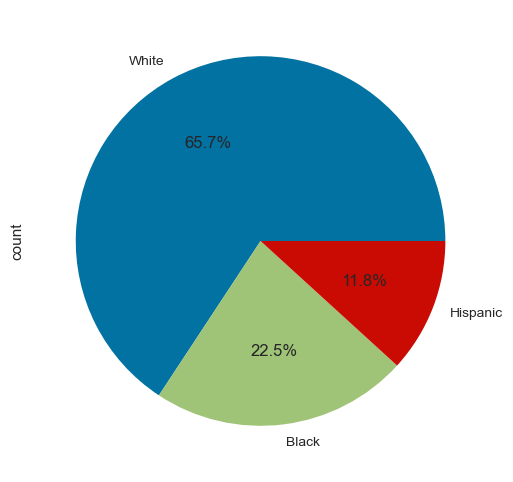

In [28]:
print(df["DODRace"].value_counts());
df["DODRace"].value_counts().plot(kind="pie", autopct='%1.1f%%',figsize=(6,6));

In [29]:
#I've found 2 columns with the same information about weight in my dataset. I will drop 'Weightlbs'.

df[['Weightlbs','weightkg']]

,Weightlbs,weightkg
0,142,657
1,120,534
2,147,663
3,175,782
4,195,886
...,...,...
4077,160,675
4078,194,896
4079,186,832
4080,165,731


In [30]:
# to find how many unique values object features have
for col in df.select_dtypes("object"):
  print(f"{col} has {df[col].nunique()} unique value")

Gender has 2 unique value
Date has 253 unique value
Installation has 12 unique value
Component has 3 unique value
Branch has 3 unique value
PrimaryMOS has 281 unique value
SubjectsBirthLocation has 136 unique value
DODRace has 3 unique value
WritingPreference has 3 unique value


In [31]:
df.select_dtypes(include='object').sample(10)

,Gender,Date,Installation,Component,Branch,PrimaryMOS,SubjectsBirthLocation,DODRace,WritingPreference
4011,Male,26-Mar-12,Camp Shelby,Army National Guard,Combat Arms,11B,Oklahoma,White,Right hand
2573,Male,19-Oct-11,Fort Bragg,Regular Army,Combat Arms,11B,North Carolina,White,Right hand
2843,Male,13-Dec-11,Fort Gordon,Regular Army,Combat Service Support,35F,District of Columbia,White,Right hand
4043,Male,29-Mar-12,Camp Shelby,Army National Guard,Combat Arms,11A,Oklahoma,White,Right hand
2753,Male,6-Dec-11,Fort Gordon,Regular Army,Combat Service Support,25B,South Carolina,White,Right hand
834,Female,15-Jul-11,Fort Lee,Regular Army,Combat Service Support,92A,Germany,Black,Right hand
781,Male,12-Jan-11,Fort Bliss,Regular Army,Combat Arms,13Z,Ohio,White,Right hand
3969,Male,25-Mar-12,Camp Shelby,Army National Guard,Combat Arms,11B,Louisiana,Black,Right hand
619,Male,10-Dec-10,Fort Bliss,Regular Army,Combat Service Support,91D,Illinois,Hispanic,Right hand
552,Male,2-Dec-10,Fort Bliss,Regular Army,Combat Arms,13D,Tennessee,White,Right hand


In [32]:
#Let's create our non-numeric list, which will cause our data to swell when we apply the get dummies operation 
#and will not yield any meaningful results, and perform our drop operation.

In [33]:
df.groupby(["Component"])["DODRace"].value_counts()

Component            DODRace 
Army National Guard  White       1855
                     Black        499
                     Hispanic     253
Army Reserve         White        114
                     Black         52
                     Hispanic      41
Regular Army         White       1823
                     Black        747
                     Hispanic     385
Name: count, dtype: int64

In [34]:
df.groupby(["Component","Branch"])["DODRace"].value_counts()

Component            Branch                  DODRace 
Army National Guard  Combat Arms             White       623
                                             Black        79
                                             Hispanic     74
                     Combat Service Support  White       917
                                             Black       312
                                             Hispanic    142
                     Combat Support          White       315
                                             Black       108
                                             Hispanic     37
Army Reserve         Combat Arms             White         5
                                             Hispanic      1
                     Combat Service Support  White        82
                                             Hispanic     30
                                             Black        24
                     Combat Support          Black        28
                               

In [35]:
# Bunları düşürelim mi?
#ınstallation: ölçüm yapılan yer +
#primary MOS: askeri bir kod sınıfı (284 unique değeri var) +
#subjectid: 284 unique değeri var +
#date: ölçüm yapılan tarih, target featureye etkisi yok +
#component: “Army National Guard”, “Army Reserve”, or “Regular Army” ????
#weightkg: Weightlbs ile aynı. +

drop_list_nonnumeric = ["Date", "Installation", "Component","PrimaryMOS", "subjectid", "weightkg"]
df.drop(drop_list_nonnumeric, axis=1, inplace=True)

In [36]:
df.shape

(5769, 100)

In [37]:
df.select_dtypes(include='object').sample(5)

,Gender,Branch,SubjectsBirthLocation,DODRace,WritingPreference
1652,Female,Combat Service Support,New York,White,Right hand
2859,Male,Combat Service Support,Texas,White,Right hand
546,Female,Combat Support,South Carolina,Black,Right hand
1406,Male,Combat Arms,Maryland,White,Right hand
477,Male,Combat Arms,West Virginia,White,Right hand


In [38]:
#outliers handling

In [39]:
#We can set a limit on the Weightlbs and Heightin columns and then drop the values outside the limit according to
#The minimum and maximum values of the height and weight of a healthy individual who can become a soldier.    

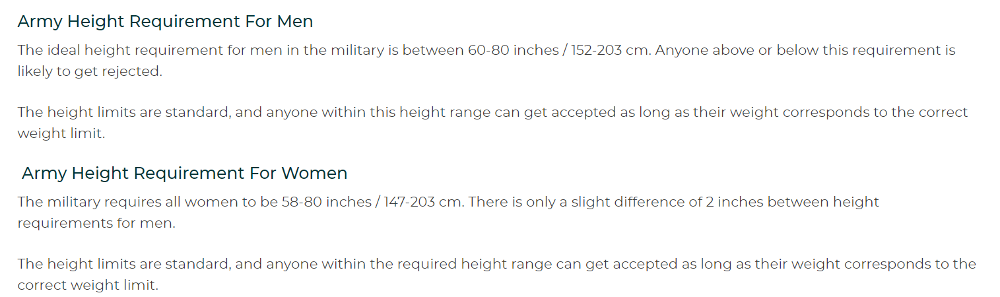

In [40]:
df.groupby(["Gender"])["Heightin"].value_counts()

Gender  Heightin
Female  64          318
        66          273
        63          233
        65          210
        62          202
        67          177
        68          103
        61           88
        69           78
        60           67
        70           49
        59           30
        71           15
        72            6
        57            5
        73            5
        58            4
        80            3
        77            2
        56            1
        75            1
Male    69          527
        71          522
        70          502
        72          462
        68          408
        67          308
        73          278
        66          249
        74          232
        75          113
        65           89
        76           68
        64           50
        77           34
        63           16
        78           15
        62            6
        79            5
        60            5
        80            4

In [41]:
df = df[(df['Heightin'] >= 59) & (df['Heightin'] <= 80)]
df = df[(df['Weightlbs'] >= 91) & (df['Weightlbs'] <= 255)]

In [42]:
df.shape

(5673, 100)

In [43]:
fig = plt.figure(figsize=(20,80), dpi=200)

for i, col in enumerate(df.select_dtypes(["float", "int"]).columns):
        plt.subplot(40,3,i+1)
        ax = sns.boxplot(x=df[col], y= df["DODRace"])
        
plt.tight_layout();

In [44]:
df.iloc[:,:-1].iplot(kind="box")

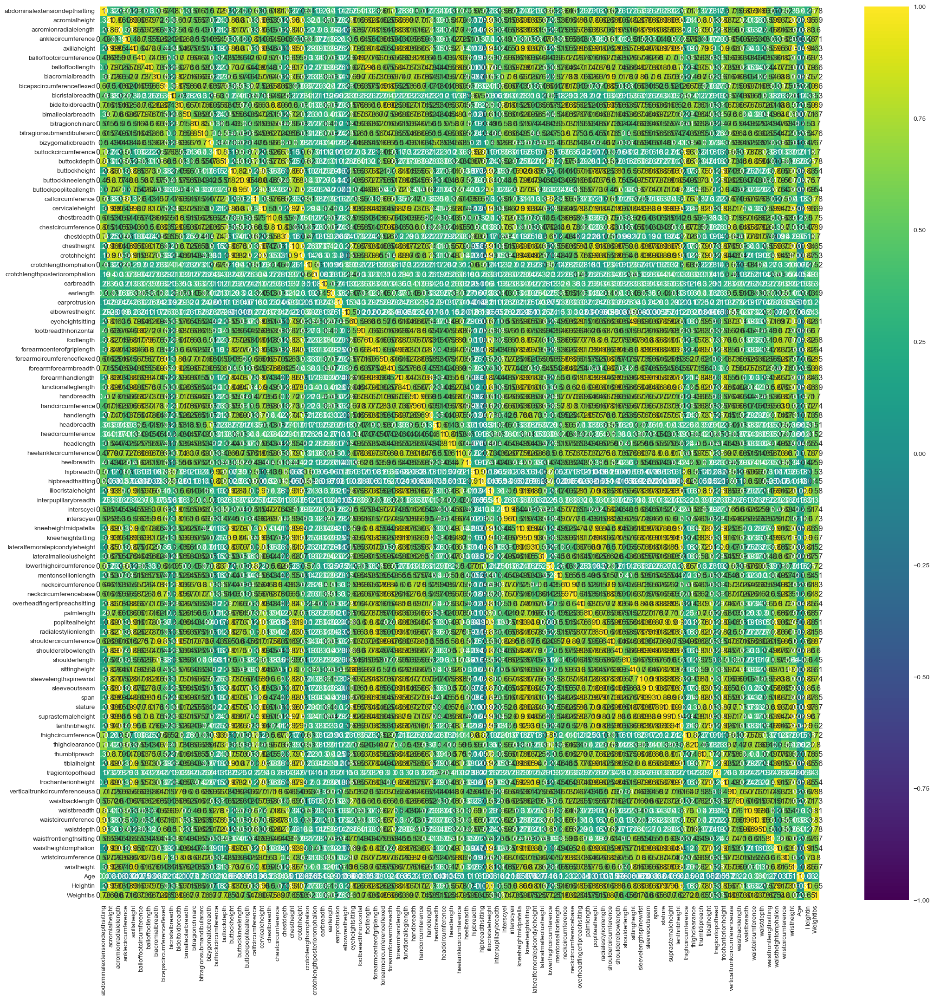

In [45]:
#Correlation
plt.figure(figsize=(25,25))
sns.heatmap(df.select_dtypes(include='number').corr(),vmin=-1,vmax=1, annot=True, cmap='viridis');

In [46]:
df_temp = df.select_dtypes(include='number').corr()

count = "done"
feature =[]
collinear=[]
for col in df_temp.columns:
    for i in df_temp.index:
        if (df_temp[col][i]> .9 and df_temp[col][i] < 1) or (df_temp[col][i]< -.9 and df_temp[col][i] > -1) :
                feature.append(col)
                collinear.append(i)
                # print(f"multicolinearity alert in between {col} - {i}")
print("Number of strong corelated features:", count)

Number of strong corelated features: done


In [47]:
df_col = pd.DataFrame([feature, collinear], index=["feature","collinear"]).T
df_col

,feature,collinear
0,abdominalextensiondepthsitting,waistcircumference
1,abdominalextensiondepthsitting,waistdepth
2,acromialheight,axillaheight
3,acromialheight,cervicaleheight
4,acromialheight,chestheight
...,...,...
277,Heightin,chestheight
278,Heightin,stature
279,Heightin,suprasternaleheight
280,Heightin,tenthribheight


In [48]:
df_col.value_counts("feature")

feature
kneeheightsitting                 18
tenthribheight                    15
waistheightomphalion              15
axillaheight                      15
iliocristaleheight                15
crotchheight                      14
cervicaleheight                   13
chestheight                       12
suprasternaleheight               12
kneeheightmidpatella              11
tibialheight                      11
acromialheight                    11
stature                           10
poplitealheight                   10
trochanterionheight                9
span                               9
Heightin                           8
lateralfemoralepicondyleheight     6
buttockheight                      6
sleeveoutseam                      6
forearmhandlength                  5
radialestylionlength               4
forearmcenterofgriplength          3
shoulderelbowlength                3
waistcircumference                 3
waistdepth                         2
sleevelengthspinewrist        

# DATA Preprocessing
- In this step we divide our data to X(Features) and y(Target) then ,
- To train and evaluation purposes we create train and test sets,
- Lastly, scale our data if features not in same scale. Why?

In [49]:
X = df.drop("DODRace",axis=1)
y = df.DODRace

In [50]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=6, stratify = y)

In [51]:
print("Train features shape : ", X_train.shape)
print("Train target shape   : ", y_train.shape)
print("Test features shape  : ", X_test.shape)
print("Test target shape    : ", y_test.shape)

Train features shape :  (4538, 99)
Train target shape   :  (4538,)
Test features shape  :  (1135, 99)
Test target shape    :  (1135,)


# Modelling
- Fit the model with train dataset
- Get predict from vanilla model on both train and test sets to examine if there is over/underfitting   
- Apply GridseachCV for both hyperparemeter tuning and sanity test of our model.
- Use hyperparameters that you find from gridsearch and make final prediction and evaluate the result according to chosen metric.

In [52]:
''' first **.fit(train)** --> 
    second **.predict(test)** --> 
    third **.predict(train)** --> 
    fourth **cross_val** --> 
    fifth **GridSearchCV** --> 
    sixth **ROC - AUC**'''

' first **.fit(train)** --> \n    second **.predict(test)** --> \n    third **.predict(train)** --> \n    fourth **cross_val** --> \n    fifth **GridSearchCV** --> \n    sixth **ROC - AUC**'

## 1. Logistic model

### Vanilla Logistic Model

In [53]:
def eval_metric(model, X_train, y_train, X_test, y_test):
    y_train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    
    print("Test_Set")
    print(confusion_matrix(y_test, y_pred))
    print(classification_report(y_test, y_pred))
    
    print()
    print("Train_Set")
    print(confusion_matrix(y_train, y_train_pred))
    print(classification_report(y_train, y_train_pred))
   # plot_confusion_matrix(model,X_test,y_test,values_format='.0f')

In [54]:
cat = X.select_dtypes("object").columns
cat 

Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object')

In [55]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler

column_trans = make_column_transformer((OneHotEncoder(handle_unknown="ignore",
                                                      sparse=False), cat),
                                                      remainder=MinMaxScaler(),
                                                      verbose_feature_names_out=False)

In [56]:
from sklearn.pipeline import Pipeline
operations = [("OneHotEncoder", column_trans), ("log", LogisticRegression(random_state=101))]

pipe_log_model = Pipeline(steps=operations)

In [57]:
LogisticRegression

sklearn.linear_model._logistic.LogisticRegression

In [58]:
pipe_log_model.fit(X_train,y_train)
eval_metric(pipe_log_model, X_train, y_train, X_test, y_test)

Test_Set
[[229   3  23]
 [  9  71  54]
 [  4  18 724]]
              precision    recall  f1-score   support

       Black       0.95      0.90      0.92       255
    Hispanic       0.77      0.53      0.63       134
       White       0.90      0.97      0.94       746

    accuracy                           0.90      1135
   macro avg       0.87      0.80      0.83      1135
weighted avg       0.90      0.90      0.90      1135


Train_Set
[[ 937   16   66]
 [  26  317  191]
 [  29   55 2901]]
              precision    recall  f1-score   support

       Black       0.94      0.92      0.93      1019
    Hispanic       0.82      0.59      0.69       534
       White       0.92      0.97      0.94      2985

    accuracy                           0.92      4538
   macro avg       0.89      0.83      0.85      4538
weighted avg       0.91      0.92      0.91      4538



In [59]:
scoring = {"f1_Hispanic" : make_scorer(f1_score, average = None, labels =["Hispanic"]),
           "precision_Hispanic" : make_scorer(precision_score, average = None, labels =["Hispanic"]),
           "recall_Hispanic" : make_scorer(recall_score, average = None, labels =["Hispanic"])}

In [60]:
operations = [("OneHotEncoder", column_trans), ("log", LogisticRegression(random_state=101))]

model = Pipeline(steps=operations)

scores = cross_validate(model, X_train, y_train, scoring = scoring, cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_f1_Hispanic            0.647700
train_f1_Hispanic           0.686139
test_precision_Hispanic     0.780069
train_precision_Hispanic    0.823258
test_recall_Hispanic        0.558106
train_recall_Hispanic       0.588225
dtype: float64

In [61]:
# multiclass datalarda CV veya gridsearchCV için precision, recall ve f1 metriclerini tek başına kullanmayız. Yukarda olduğu
# gibi precision_weighted, precision_macro, precision_micro vb. yazmalıyız. Yoksa hata alırsınız. Spesifik olarak tek bir 
# sınıfa ait CV scorlarını görmek istiyorsak aşağıda gösterildiği gibi make_scorer fonksiyonunu kullanmalıyız.

operations = [("OneHotEncoder", column_trans),("scaler", MinMaxScaler()), ("logistic", LogisticRegression())]

model = Pipeline(steps=operations)

scores = cross_validate(model, X_train, y_train, scoring = ['accuracy', 'precision_weighted','recall_weighted',
                                                                   'f1_weighted'], cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]


test_accuracy               0.902602
train_accuracy              0.915577
test_precision_weighted     0.898978
train_precision_weighted    0.912606
test_recall_weighted        0.902602
train_recall_weighted       0.915577
test_f1_weighted            0.897630
train_f1_weighted           0.911176
dtype: float64

In [62]:
operations = [("OneHotEncoder", column_trans),("scaler", MinMaxScaler()), ("logistic", LogisticRegression())]

y_pred=pipe_log_model.predict(X_test)
y_pred_proba = pipe_log_model.predict_proba(X_test)

test_data = pd.concat([X_test, y_test], axis=1)
test_data["pred"] = y_pred
test_data["pred_proba_White"] = y_pred_proba[:,0]
test_data["pred_proba_Black"] = y_pred_proba[:,1]
test_data["pred_proba_Hispanic"] = y_pred_proba[:,2]
test_data.sample(10)

# multiclass datalarda 0.5 thresholdu aranmaz. Hangi classa ait olasılık yüksek ise o sınıfa atanır.

,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,...,SubjectsBirthLocation,Age,Heightin,Weightlbs,WritingPreference,DODRace,pred,pred_proba_White,pred_proba_Black,pred_proba_Hispanic
1167,247,1472,340,226,1356,247,203,408,348,260,...,Indiana,24,71,170,Right hand,White,White,0.009812,0.023067,0.967121
876,260,1415,330,218,1302,244,188,424,347,283,...,North Carolina,41,69,190,Right hand,White,White,0.001596,0.004800,0.993604
215,186,1267,300,197,1178,221,181,383,277,229,...,Florida,23,62,110,Right hand,Black,White,0.223506,0.165758,0.610736
3130,252,1352,314,210,1240,242,189,404,418,261,...,Illinois,37,66,178,Left hand,Black,Black,0.861807,0.035351,0.102842
1427,260,1383,343,263,1273,245,199,378,384,313,...,Alabama,41,66,200,Right hand,Black,Black,0.981299,0.000552,0.018150
1468,206,1290,288,203,1178,224,170,335,292,264,...,Alabama,53,61,123,Right hand,White,White,0.063263,0.056065,0.880672
3828,288,1417,351,224,1297,238,206,399,355,292,...,Louisiana,44,69,193,Right hand,White,White,0.009658,0.010781,0.979561
3122,241,1312,308,219,1212,239,185,407,352,291,...,Louisiana,18,64,165,Right hand,White,White,0.002119,0.033404,0.964478
2054,254,1475,356,203,1362,254,202,432,346,288,...,Alaska,40,71,190,Right hand,White,White,0.089725,0.026056,0.884219
1071,242,1310,315,248,1216,229,171,343,310,258,...,California,30,63,143,Right hand,White,White,0.012863,0.256195,0.730942


### Logistic Model GridsearchCV

In [63]:
recall_Hispanic =  make_scorer(recall_score, average=None, labels=["Hispanic"])

In [64]:
param_grid = {
    "log__C": [0.5, 1],
    'log__penalty': ["l1", "l2"],
    'log__solver': ['liblinear', 'lbfgs'],
}

In [65]:
operations = [("OneHotEncoder", column_trans),("scaler", MinMaxScaler()), ("logistic", LogisticRegression())]

model = Pipeline(steps=operations)

log_model_grid = GridSearchCV(model,
                              param_grid,
                              scoring=recall_Hispanic,
                              cv=10,
                              n_jobs=-1,
                              return_train_score=True)

model.get_params()

{'memory': None,
 'steps': [('OneHotEncoder',
   ColumnTransformer(remainder=MinMaxScaler(),
                     transformers=[('onehotencoder',
                                    OneHotEncoder(handle_unknown='ignore',
                                                  sparse=False),
                                    Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                     verbose_feature_names_out=False)),
  ('scaler', MinMaxScaler()),
  ('logistic', LogisticRegression())],
 'verbose': False,
 'OneHotEncoder': ColumnTransformer(remainder=MinMaxScaler(),
                   transformers=[('onehotencoder',
                                  OneHotEncoder(handle_unknown='ignore',
                                                sparse=False),
                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                   verbose_feature_names_out=False),
 'scaler': M

In [66]:
operations = [("OneHotEncoder", column_trans), 
              ("log", LogisticRegression(class_weight='balanced',
                                         max_iter=10000,
                                         random_state=101))]

model = Pipeline(steps=operations)

log_model_grid = GridSearchCV(model,
                              param_grid,
                              scoring=recall_Hispanic,
                              cv=10,
                              n_jobs=-1,
                              return_train_score=True)
#scoring = f1_Hispanic = make_scorer(f1_score, average = None, labels =["Hispanic"]) 

# scoring clasification datalarında default olarak acuuracy'dir. Eğer özellikle bir sınıfa ait metriclerin iyileştirilmesini
# istiyorsak yukarda scoring parametresi olarak make_scorer fonksiyonunu tanımlamalıyız.

# Eğer modelin Hispanic classının f1_scorunu iyileştirecek şekilde en iyi paramatreleri bulmasını istesydik,
# scoring = make_scorer(f1_score, average = None, labels =["Hispanic"]) olarak düzenlemeliydik.

In [67]:
log_model_grid.fit(X_train,y_train)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('OneHotEncoder',
                                        ColumnTransformer(remainder=MinMaxScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse=False),
                                                                         Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                                                          verbose_feature_names_out=False)),
                                       ('log',
                                        LogisticRegression(class_weight='balanced',
                                                           max_iter=10000,
                                                           random_stat

In [68]:
log_model_grid.best_params_

{'log__C': 0.5, 'log__penalty': 'l1', 'log__solver': 'liblinear'}

In [69]:
log_model_grid.best_estimator_

Pipeline(steps=[('OneHotEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('log',
                 LogisticRegression(C=0.5, class_weight='balanced',
                                    max_iter=10000, penalty='l1',
                                    random_state=101, solver='liblinear'))])

In [70]:
pd.DataFrame(log_model_grid.cv_results_).loc[log_model_grid.best_index_, ["mean_test_score", "mean_train_score"]]

mean_test_score     0.653389
mean_train_score    0.683524
Name: 0, dtype: object

In [71]:
y_pred = log_model_grid.predict(X_test)
y_pred

array(['White', 'Hispanic', 'Black', ..., 'White', 'Hispanic', 'White'],
      dtype=object)

In [72]:
eval_metric(log_model_grid, X_train, y_train, X_test, y_test)

Test_Set
[[237   4  14]
 [  7  84  43]
 [  8  28 710]]
              precision    recall  f1-score   support

       Black       0.94      0.93      0.93       255
    Hispanic       0.72      0.63      0.67       134
       White       0.93      0.95      0.94       746

    accuracy                           0.91      1135
   macro avg       0.86      0.84      0.85      1135
weighted avg       0.91      0.91      0.91      1135


Train_Set
[[ 947   20   52]
 [  28  370  136]
 [  56  139 2790]]
              precision    recall  f1-score   support

       Black       0.92      0.93      0.92      1019
    Hispanic       0.70      0.69      0.70       534
       White       0.94      0.93      0.94      2985

    accuracy                           0.91      4538
   macro avg       0.85      0.85      0.85      4538
weighted avg       0.90      0.91      0.90      4538



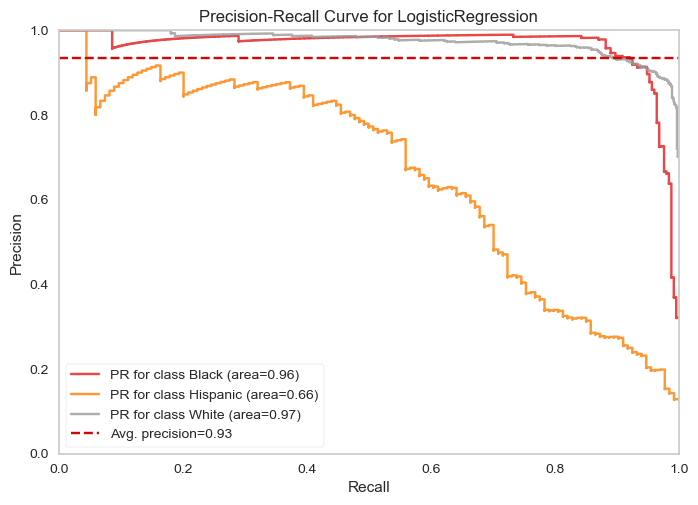

In [73]:
from yellowbrick.classifier import PrecisionRecallCurve

operations = [("OneHotEncoder", column_trans), ("log", LogisticRegression(class_weight='balanced',max_iter=10000,
                                                                          random_state=101))]

model = Pipeline(steps=operations)

viz = PrecisionRecallCurve(
    model,
    per_class=True, classes= ["Black", "Hispanic", "White"],
    cmap="Set1"
)
viz.fit(X_train, y_train)
viz.score(X_test, y_test)
viz.show();

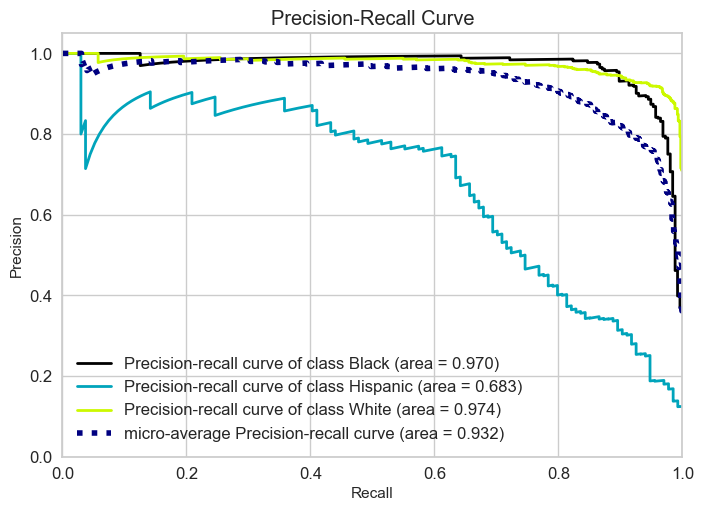

In [74]:
from scikitplot.metrics import plot_roc, plot_precision_recall

operations = [("OneHotEncoder", column_trans), 
              ("log", LogisticRegression(class_weight='balanced',
                                         max_iter=10000,
                                         random_state=101))]

model = Pipeline(steps=operations)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();

In [75]:
viz.score_  # Hispanic score low.

{'Black': 0.9649524255307556,
 'Hispanic': 0.6612097055019701,
 'White': 0.9733593517922448,
 'micro': 0.9332702446144453}

In [76]:
from sklearn.metrics import average_precision_score

y_test_dummies = pd.get_dummies(y_test).values

average_precision_score(y_test_dummies[:, 1], y_pred_proba[:, 1])

# 0 black, 1 hispanic, 2 white skorlarını döndürür.
# Burda 1 vererek hispanic skorları aldık.

0.6828171468065616

In [77]:
y_pred = log_model_grid.predict(X_test)

log_AP = average_precision_score(y_test_dummies[:, 1], y_pred_proba[:, 1])
log_f1 = f1_score(y_test, y_pred, average=None, labels=["Hispanic"])
log_recall = recall_score(y_test, y_pred, average=None, labels=["Hispanic"])

# tüm modellerden aldığımız skorları aşağıda tabloda karşılaştıracağımızdan skorlarımızı değişkenlere atıyoruz.

In [78]:
from sklearn.metrics import make_scorer
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score, roc_auc_score


f1_Hispanic = make_scorer(f1_score, average = None, labels =["Hispanic"])
precision_Hispanic = make_scorer(precision_score, average = None, labels =["Hispanic"])
recall_Hispanic = make_scorer(recall_score, average = None, labels =["Hispanic"])


scoring = {"f1_Hispanic":f1_Hispanic, 
           "precision_Hispanic":precision_Hispanic,
           "recall_Hispanic":recall_Hispanic}

# Multiclass datalarda hedef labelınız ne ise onun üzerinden CV scorlarını alabilirsiniz. 
# Yine make_scorer fonksiyonunu kullanmak zorundayız. Data multi class olduğunda make_scorer fonksiyonu içine average, ve labels
# parametreleri mutlaka belirtilmelidir.

In [79]:
operations = [("OneHotEncoder", column_trans),("scaler", MinMaxScaler()), ("logistic", LogisticRegression())]
model = Pipeline(steps=operations)

scores = cross_validate(model, X_train, y_train, scoring = scoring, cv = 10, return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]


test_f1_Hispanic            0.646975
train_f1_Hispanic           0.685176
test_precision_Hispanic     0.777977
train_precision_Hispanic    0.822524
test_recall_Hispanic        0.558106
train_recall_Hispanic       0.587184
dtype: float64

## 2. SVC

### Vanilla SVC model 

In [80]:
operations_svc = [("OneHotEncoder", column_trans), ("svc", SVC(class_weight="balanced",random_state=101))]
pipe_svc_model = Pipeline(steps=operations_svc)

In [81]:
pipe_svc_model.fit(X_train, y_train)
eval_metric(pipe_svc_model, X_train, y_train, X_test, y_test)

Test_Set
[[231  13  11]
 [  8 101  25]
 [ 14 103 629]]
              precision    recall  f1-score   support

       Black       0.91      0.91      0.91       255
    Hispanic       0.47      0.75      0.58       134
       White       0.95      0.84      0.89       746

    accuracy                           0.85      1135
   macro avg       0.77      0.83      0.79      1135
weighted avg       0.88      0.85      0.86      1135


Train_Set
[[ 944   33   42]
 [  21  451   62]
 [  53  380 2552]]
              precision    recall  f1-score   support

       Black       0.93      0.93      0.93      1019
    Hispanic       0.52      0.84      0.65       534
       White       0.96      0.85      0.90      2985

    accuracy                           0.87      4538
   macro avg       0.80      0.88      0.83      4538
weighted avg       0.90      0.87      0.88      4538



In [82]:
model = Pipeline(steps=operations_svc)

scores = cross_validate(model, 
                        X_train, 
                        y_train, 
                        scoring=scoring,
                        cv=10, 
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_f1_Hispanic            0.589094
train_f1_Hispanic           0.644352
test_precision_Hispanic     0.477831
train_precision_Hispanic    0.521070
test_recall_Hispanic        0.771454
train_recall_Hispanic       0.844149
dtype: float64

###  SVC Model GridsearchCV

In [83]:
param_grid = {'SVC__C': [ 0.6, 0.9],
              'SVC__gamma': ["scale", "auto"],
              'SVC__kernel': ['rbf', 'linear']}

In [84]:
operations_svc = [("OneHotEncoder", column_trans), ("scaler",MinMaxScaler()),
              ("SVC", SVC(class_weight="balanced", probability=True,max_iter=100000),)]

model = Pipeline(steps=operations_svc)

svm_model_grid = GridSearchCV(model, 
                              param_grid=param_grid, 
                              scoring= 
                                    'f1_weighted', 
                              cv=5, 
                              return_train_score=True, n_jobs=-1)

# SVC predict_proba üzerinden prediction yapmaz. Tahminleri decision_function 
# üzerinden yapar. Eğer predict_proba almak istiyorsak SVC'nin probabilty 
# hyper_parametresini True olarak düzenlememiz gerekiyor.
# Decision_functionun ne olduğuna aşağıda değineceğiz.

In [85]:
svm_model_grid.fit(X_train, y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('OneHotEncoder',
                                        ColumnTransformer(remainder=MinMaxScaler(),
                                                          transformers=[('onehotencoder',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse=False),
                                                                         Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                                                          verbose_feature_names_out=False)),
                                       ('scaler', MinMaxScaler()),
                                       ('SVC',
                                        SVC(class_weight='balanced',
                                            max_iter=100000,
                                 

In [86]:
svm_model_grid.best_estimator_

Pipeline(steps=[('OneHotEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('scaler', MinMaxScaler()),
                ('SVC',
                 SVC(C=0.9, class_weight='balanced', kernel='linear',
                     max_iter=100000, probability=True))])

In [87]:
pd.DataFrame(svm_model_grid.cv_results_).loc[svm_model_grid.best_index_, ["mean_test_score", "mean_train_score"]]

#overfiting kontrolümüzü yapıyoruz.

mean_test_score     0.864208
mean_train_score    0.887542
Name: 5, dtype: object

In [88]:
eval_metric(svm_model_grid, X_train, y_train, X_test, y_test)

Test_Set
[[233  10  12]
 [  8 101  25]
 [ 16  97 633]]
              precision    recall  f1-score   support

       Black       0.91      0.91      0.91       255
    Hispanic       0.49      0.75      0.59       134
       White       0.94      0.85      0.89       746

    accuracy                           0.85      1135
   macro avg       0.78      0.84      0.80      1135
weighted avg       0.88      0.85      0.86      1135


Train_Set
[[ 966   28   25]
 [  18  459   57]
 [  71  343 2571]]
              precision    recall  f1-score   support

       Black       0.92      0.95      0.93      1019
    Hispanic       0.55      0.86      0.67       534
       White       0.97      0.86      0.91      2985

    accuracy                           0.88      4538
   macro avg       0.81      0.89      0.84      4538
weighted avg       0.91      0.88      0.89      4538



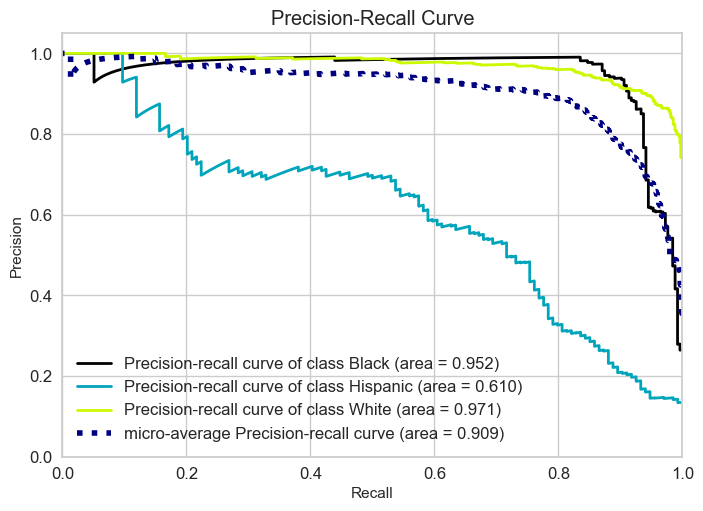

In [89]:
operations = [("OneHotEncoder", column_trans), 
              ("svc", SVC(C=1, class_weight="balanced",random_state=101))]

model = Pipeline(steps=operations)

model.fit(X_train, y_train)

decision_function = model.decision_function(X_test)

#y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, decision_function)
plt.show();

In [90]:
decision_function

array([[-0.16522279,  1.08179529,  2.13224444],
       [-0.26204854,  2.24693054,  1.14999971],
       [ 1.08339863,  2.18541547, -0.20449315],
       ...,
       [ 0.89403661, -0.16419379,  2.19654185],
       [-0.21660841,  2.26042092,  0.78939715],
       [-0.22005141,  1.13961547,  2.18330455]])

In [91]:
average_precision_score(y_test_dummies[:, 1], decision_function[:, 1])

0.6096815565890359

In [92]:
y_pred = svm_model_grid.predict(X_test)

svc_AP = average_precision_score(y_test_dummies[:, 1], decision_function[:, 1])
svc_f1 = f1_score(y_test, y_pred, average=None, labels=["Hispanic"])
svc_recall = recall_score(y_test, y_pred, average=None, labels=["Hispanic"])

## 3. RF

In [93]:
cat

Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object')

In [94]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OrdinalEncoder


ord_enc = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)

column_trans = make_column_transformer((ord_enc, cat), remainder='passthrough')

### Vanilla RF Model

In [95]:
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier


operations_rf = [("OrdinalEncoder", column_trans), ("RF_model", RandomForestClassifier(class_weight="balanced", 
                                                                                    random_state=101))]

pipe_model_rf = Pipeline(steps=operations_rf)

pipe_model_rf.fit(X_train, y_train)

Pipeline(steps=[('OrdinalEncoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinalencoder',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('RF_model',
                 RandomForestClassifier(class_weight='balanced',
                                        random_state=101))])

In [96]:
#X_train["Gender"] = X_train.Gender.map({"Male": 0, "Female": 1})

In [97]:

param_grid = {'RF_model__n_estimators':[400,500],
             'RF_model__max_depth':[2,3]} #'min_samples_split':[18,20,22], 'max_features': ['auto', None, 15, 20]
             

In [98]:
operations_rf = [("OrdinalEncoder", column_trans),
                 ("RF_model", RandomForestClassifier(class_weight="balanced",
                                                     random_state=101))]

model = Pipeline(steps=operations_rf)
rf_grid_model = GridSearchCV(model,
                             param_grid,
                             scoring=recall_Hispanic,
                             n_jobs=-1,
                             return_train_score=True)

In [99]:
rf_grid_model.fit(X_train,y_train)

GridSearchCV(estimator=Pipeline(steps=[('OrdinalEncoder',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('ordinalencoder',
                                                                         OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                                        unknown_value=-1),
                                                                         Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                                       ('RF_model',
                                        RandomForestClassifier(class_weight='balanced',
                                                               random_state=101))]),
             n_jobs=-1,
             param_grid={'RF_model__max_depth': [2, 3],
                         'RF_model__n_estimators': [400, 500]},


In [100]:
rf_grid_model.best_params_

{'RF_model__max_depth': 3, 'RF_model__n_estimators': 500}

In [101]:
pd.DataFrame(rf_grid_model.cv_results_).loc[rf_grid_model.best_index_, ["mean_test_score", "mean_train_score"]]

mean_test_score     0.606701
mean_train_score    0.652624
Name: 3, dtype: object

In [102]:
rf_grid_model.best_score_

0.6067007582436961

In [103]:
eval_metric(rf_grid_model, X_train, y_train, X_test, y_test)

Test_Set
[[190  41  24]
 [ 16  76  42]
 [ 67 230 449]]
              precision    recall  f1-score   support

       Black       0.70      0.75      0.72       255
    Hispanic       0.22      0.57      0.32       134
       White       0.87      0.60      0.71       746

    accuracy                           0.63      1135
   macro avg       0.60      0.64      0.58      1135
weighted avg       0.76      0.63      0.67      1135


Train_Set
[[ 787  136   96]
 [  50  342  142]
 [ 249  994 1742]]
              precision    recall  f1-score   support

       Black       0.72      0.77      0.75      1019
    Hispanic       0.23      0.64      0.34       534
       White       0.88      0.58      0.70      2985

    accuracy                           0.63      4538
   macro avg       0.61      0.67      0.60      4538
weighted avg       0.77      0.63      0.67      4538



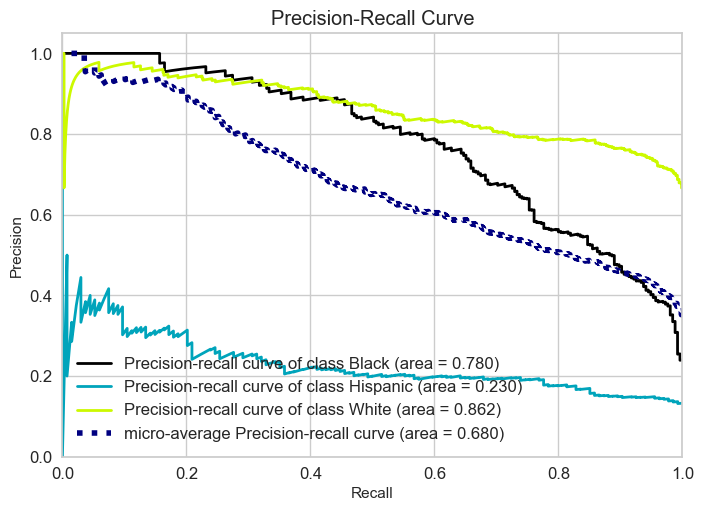

In [104]:
operations_rf = [("OrdinalEncoder", column_trans), 
                 ("RF_model", RandomForestClassifier(class_weight="balanced",
                                                     max_depth=2, 
                                                     n_estimators=400, 
                                                     random_state=101))]

model = Pipeline(steps=operations_rf)

model.fit(X_train, y_train)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test, y_pred_proba)
plt.show();

In [105]:
y_test_dummies = pd.get_dummies(y_test).values
average_precision_score(y_test_dummies[:, 1], y_pred_proba[:, 1])

0.23042678674823522

In [106]:
y_pred = rf_grid_model.predict(X_test)

rf_AP = average_precision_score(y_test_dummies[:, 1], y_pred_proba[:, 1])
rf_f1 = f1_score(y_test, y_pred, average=None, labels=["Hispanic"])
rf_recall = recall_score(y_test, y_pred, average=None, labels=["Hispanic"])

## 4. XGBoost

### Vanilla XGBoost Model

In [107]:
pip install xgboost

Note: you may need to restart the kernel to use updated packages.


In [108]:
from xgboost import XGBClassifier

In [109]:
operations_xgb = [("OrdinalEncoder", column_trans), 
                  ("XGB_model", XGBClassifier(random_state=101))]

pipe_model_xgb = Pipeline(steps=operations_xgb)

y_train_xgb = y_train.map({"Black":0, "Hispanic":1, "White":2}) # sıralama classification_report ile aynı olacak.
y_test_xgb = y_test.map({"Black":0, "Hispanic":1, "White":2})
# xgb 1.6 ve üzeri versiyonlarda target numeric olmaz ise hata döndürüyor. Bu sebeple manuel olarak dönüşümü yapıyoruz.


pipe_model_xgb.fit(X_train, y_train_xgb) 

Pipeline(steps=[('OrdinalEncoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinalencoder',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('XGB_model',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_byl...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_lea

In [110]:
eval_metric(pipe_model_xgb, X_train, y_train_xgb, X_test, y_test_xgb)

Test_Set
[[220   1  34]
 [  9  48  77]
 [ 10  12 724]]
              precision    recall  f1-score   support

           0       0.92      0.86      0.89       255
           1       0.79      0.36      0.49       134
           2       0.87      0.97      0.92       746

    accuracy                           0.87      1135
   macro avg       0.86      0.73      0.77      1135
weighted avg       0.87      0.87      0.86      1135


Train_Set
[[1019    0    0]
 [   0  534    0]
 [   0    0 2985]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1019
           1       1.00      1.00      1.00       534
           2       1.00      1.00      1.00      2985

    accuracy                           1.00      4538
   macro avg       1.00      1.00      1.00      4538
weighted avg       1.00      1.00      1.00      4538



In [111]:
from sklearn.utils import class_weight
classes_weights = class_weight.compute_sample_weight(class_weight='balanced', 
                                                     y=y_train_xgb)
classes_weights

# XGboost algortimasının multiclass datalar için weight_class hyper parametresi olmadığından. fit fonksiyonu içinde 
# sample_weight hyper paremetresini kullanabiliyoruz.

array([0.506756  , 0.506756  , 1.48446189, ..., 0.506756  , 0.506756  ,
       1.48446189])

In [112]:
my_dict = {"weights": classes_weights, "label":y_train_xgb}

comp = pd.DataFrame(my_dict)

comp.head()

,weights,label
365,0.506756,2
2961,0.506756,2
1396,1.484462,0
18,1.484462,0
3746,2.832709,1


In [113]:
comp.groupby("label").value_counts()

label  weights 
0      1.484462    1019
1      2.832709     534
2      0.506756    2985
Name: count, dtype: int64

In [114]:
pipe_model_xgb.fit(X_train,
                   y_train_xgb,  
                   XGB_model__sample_weight=classes_weights)

Pipeline(steps=[('OrdinalEncoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinalencoder',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('XGB_model',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_byl...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_lea

In [115]:
eval_metric(pipe_model_xgb, X_train, y_train_xgb, X_test, y_test_xgb)

Test_Set
[[224   4  27]
 [ 10  60  64]
 [  9  22 715]]
              precision    recall  f1-score   support

           0       0.92      0.88      0.90       255
           1       0.70      0.45      0.55       134
           2       0.89      0.96      0.92       746

    accuracy                           0.88      1135
   macro avg       0.84      0.76      0.79      1135
weighted avg       0.87      0.88      0.87      1135


Train_Set
[[1019    0    0]
 [   0  534    0]
 [   0    0 2985]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1019
           1       1.00      1.00      1.00       534
           2       1.00      1.00      1.00      2985

    accuracy                           1.00      4538
   macro avg       1.00      1.00      1.00      4538
weighted avg       1.00      1.00      1.00      4538



In [116]:
scoring_xgb = {"precision_Hispanic" : make_scorer(precision_score, average = None, labels =[1]),
           "recall_Hispanic" : make_scorer(recall_score, average = None, labels =[1]),
           "f1_Hispanic" : make_scorer(f1_score, average = None, labels =[1])}

# xgb kategorik target kabul etmediğinden hispaniclere karşılık gelen 1 numeric classına göre scoring_xgb'u düzenliyoruz.

In [117]:
operations_xgb = [("OrdinalEncoder", column_trans), 
                  ("XGB_model", XGBClassifier(random_state=101))]

model = Pipeline(steps=operations_xgb)

scores = cross_validate(model, 
                        X_train, 
                        y_train_xgb, 
                        scoring=scoring_xgb,
                        cv=5, 
                        return_train_score=True,
                        fit_params={"XGB_model__sample_weight":classes_weights})
df_scores = pd.DataFrame(scores, index = range(1, 6))
df_scores.mean()[2:]

test_precision_Hispanic     0.708633
train_precision_Hispanic    1.000000
test_recall_Hispanic        0.432710
train_recall_Hispanic       1.000000
test_f1_Hispanic            0.533279
train_f1_Hispanic           1.000000
dtype: float64

In [118]:
operations_xgb = [("OrdinalEncoder", column_trans), 
                  ("XGB_model", XGBClassifier(random_state=101))]

model = Pipeline(steps=operations_xgb)

scores = cross_validate(model, 
                        X_train, 
                        y_train_xgb, 
                        scoring=scoring_xgb,
                        cv=5, 
                        return_train_score=True,
                        fit_params={"XGB_model__sample_weight":classes_weights})
df_scores = pd.DataFrame(scores, index = range(1, 6))
df_scores.mean()[2:]

test_precision_Hispanic     0.708633
train_precision_Hispanic    1.000000
test_recall_Hispanic        0.432710
train_recall_Hispanic       1.000000
test_f1_Hispanic            0.533279
train_f1_Hispanic           1.000000
dtype: float64

### XGBoost Model GridsearchCV

In [119]:
param_grid = {"XGB_model__n_estimators":[20, 40],
              'XGB_model__max_depth':[1,2],
              "XGB_model__learning_rate": [0.03, 0.05],
              "XGB_model__subsample":[0.8, 1],
              "XGB_model__colsample_bytree":[0.8, 1]}

In [120]:
operations_xgb = [("OrdinalEncoder", column_trans),
                  ("XGB_model", XGBClassifier(random_state=101))]

model = Pipeline(steps=operations_xgb)

xgb_grid_model = GridSearchCV(model, 
                              param_grid, 
                              scoring=make_scorer(recall_score, average = None, labels =[1]),
                              cv=5,
                              n_jobs=-1,
                              return_train_score=True)

In [121]:
xgb_grid_model.fit(X_train,
                   y_train_xgb,
                   XGB_model__sample_weight=classes_weights)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('OrdinalEncoder',
                                        ColumnTransformer(remainder='passthrough',
                                                          transformers=[('ordinalencoder',
                                                                         OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                                        unknown_value=-1),
                                                                         Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                                       ('XGB_model',
                                        XGBClassifier(base_score=None,
                                                      booster=None,...
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
          

In [122]:
xgb_grid_model.best_estimator_

Pipeline(steps=[('OrdinalEncoder',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('ordinalencoder',
                                                  OrdinalEncoder(handle_unknown='use_encoded_value',
                                                                 unknown_value=-1),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('XGB_model',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_byl...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=2, max_leaves

---
---

In [123]:
xgb_grid_model.best_params_

{'XGB_model__colsample_bytree': 0.8,
 'XGB_model__learning_rate': 0.05,
 'XGB_model__max_depth': 2,
 'XGB_model__n_estimators': 40,
 'XGB_model__subsample': 1}

In [124]:
pd.DataFrame(xgb_grid_model.cv_results_).loc[xgb_grid_model.best_index_, ["mean_test_score", "mean_train_score"]]

mean_test_score     0.571116
mean_train_score    0.645122
Name: 15, dtype: object

In [125]:
xgb_grid_model.best_score_

0.5711162052548051

In [126]:
eval_metric(xgb_grid_model, X_train, y_train_xgb, X_test, y_test_xgb)

Test_Set
[[189  36  30]
 [ 15  80  39]
 [ 82 154 510]]
              precision    recall  f1-score   support

           0       0.66      0.74      0.70       255
           1       0.30      0.60      0.40       134
           2       0.88      0.68      0.77       746

    accuracy                           0.69      1135
   macro avg       0.61      0.67      0.62      1135
weighted avg       0.76      0.69      0.71      1135


Train_Set
[[ 798  134   87]
 [  69  342  123]
 [ 292  673 2020]]
              precision    recall  f1-score   support

           0       0.69      0.78      0.73      1019
           1       0.30      0.64      0.41       534
           2       0.91      0.68      0.77      2985

    accuracy                           0.70      4538
   macro avg       0.63      0.70      0.64      4538
weighted avg       0.79      0.70      0.72      4538



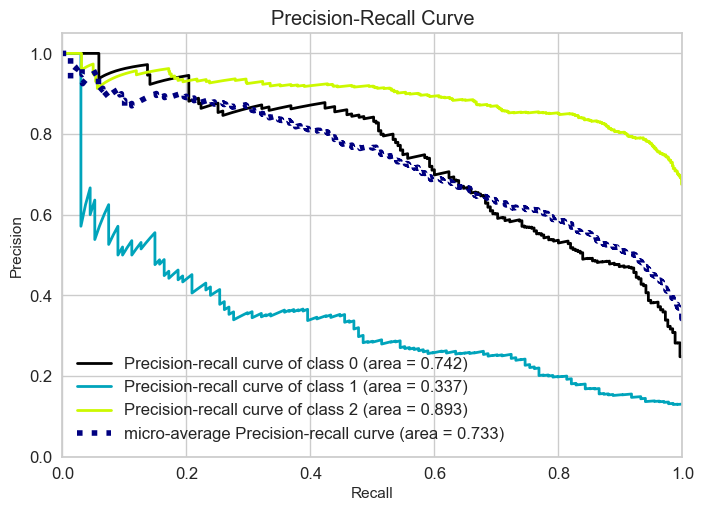

In [127]:
from scikitplot.metrics import plot_roc, precision_recall_curve


operations_xgb = [("OrdinalEncoder", column_trans), 
                  ("XGB_model", XGBClassifier(colsample_bytree=0.8,
                                              learning_rate=0.05,
                                              max_depth=2,
                                              n_estimators=20,
                                              subsample=0.8,
                                              random_state=101))]

model = Pipeline(steps=operations_xgb)

model.fit(X_train, 
          y_train_xgb, 
          XGB_model__sample_weight=classes_weights)

y_pred_proba = model.predict_proba(X_test)
    
plot_precision_recall(y_test_xgb, y_pred_proba)
plt.show()

In [128]:
y_test_xgb_dummies = pd.get_dummies(y_test_xgb).values

In [129]:
average_precision_score(y_test_xgb_dummies[:, 1], y_pred_proba[:, 1])

0.3374032991366816

In [130]:
y_pred = xgb_grid_model.predict(X_test)

xgb_AP = average_precision_score(y_test_xgb_dummies[:, 1], y_pred_proba[:, 1])
xgb_f1 = f1_score(y_test_xgb, y_pred, average=None, labels=[1])
xgb_recall = recall_score(y_test_xgb, y_pred, average=None, labels=[1])

In [131]:
## Comparing Models

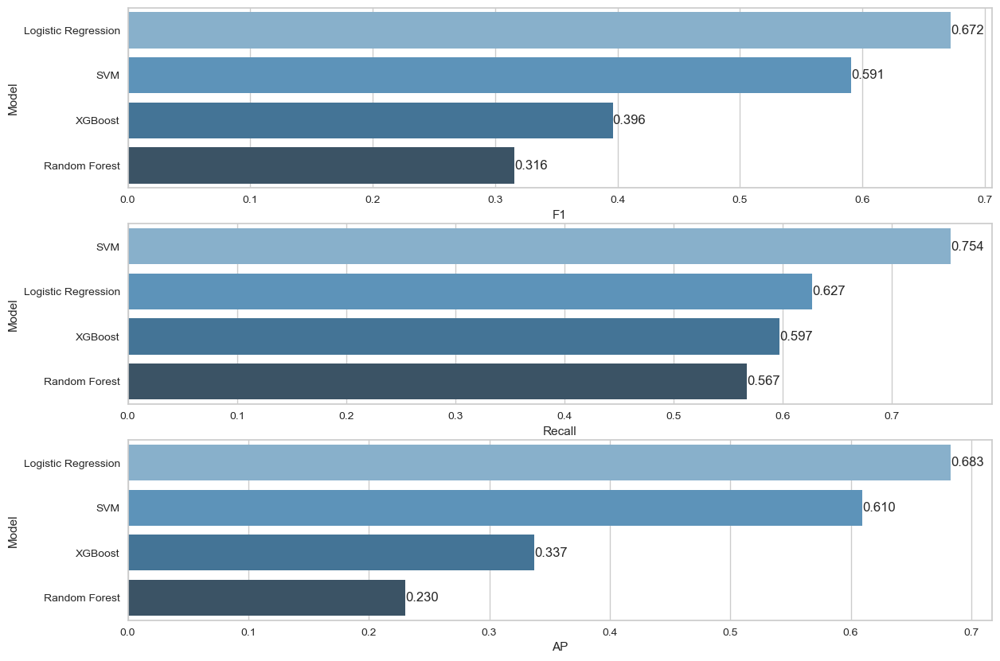

In [132]:
compare = pd.DataFrame({"Model": ["Logistic Regression", "SVM",  "Random Forest", "XGBoost"],
                        "F1": [log_f1[0], svc_f1[0], rf_f1[0], xgb_f1[0]],
                        "Recall": [log_recall[0], svc_recall[0], rf_recall[0], xgb_recall[0]],
                        "AP": [log_AP, svc_AP, rf_AP, xgb_AP]})

    
plt.figure(figsize=(14,10))
plt.subplot(311)
compare = compare.sort_values(by="F1", ascending=False)
ax=sns.barplot(x="F1", y="Model", data=compare, palette="Blues_d")
ax.bar_label(ax.containers[0],fmt="%.3f")

plt.subplot(312)
compare = compare.sort_values(by="Recall", ascending=False)
ax=sns.barplot(x="Recall", y="Model", data=compare, palette="Blues_d")
ax.bar_label(ax.containers[0],fmt="%.3f")

plt.subplot(313)
compare = compare.sort_values(by="AP", ascending=False)
ax=sns.barplot(x="AP", y="Model", data=compare, palette="Blues_d")
ax.bar_label(ax.containers[0],fmt="%.3f")
plt.show();

---
---

# SMOTE
https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/

##  Smote implement

In [133]:
!pip install imblearn

In [134]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as imbpipeline

In [135]:
column_trans = make_column_transformer((OneHotEncoder(handle_unknown="ignore", 
                                                      sparse=False), cat), 
                                       remainder=MinMaxScaler())

In [136]:
X_train_ohe = column_trans.fit_transform(X_train)

In [137]:
over = SMOTE()
X_train_over, y_train_over = over.fit_resample(X_train_ohe, y_train)


In [138]:
X_train_over.shape

(8955, 232)

In [139]:
y_train_over.value_counts()

DODRace
White       2985
Black       2985
Hispanic    2985
Name: count, dtype: int64

In [140]:
under = RandomUnderSampler()
X_train_under, y_train_under = under.fit_resample(X_train_ohe, y_train)

In [141]:
X_train_under.shape

(1602, 232)

In [142]:
y_train_under.value_counts()

DODRace
Black       534
Hispanic    534
White       534
Name: count, dtype: int64

In [143]:
over = SMOTE(sampling_strategy={"Hispanic": 1000})
under = RandomUnderSampler(sampling_strategy={"White": 2500})

In [144]:
y_train.value_counts()

DODRace
White       2985
Black       1019
Hispanic     534
Name: count, dtype: int64

In [145]:
X_resampled_over, y_resampled_over = over.fit_resample(X_train_ohe, y_train)

In [146]:
y_resampled_over.value_counts()
# Overfitting olup olmadığını kontrol ediyoruz.

DODRace
White       2985
Black       1019
Hispanic    1000
Name: count, dtype: int64

In [147]:
# Yaptığımız over_sampling ve under_sampling işlemlerimizi otomotize hale getiriyoruz.
steps = [('o', over), ('u', under)]


pipeline = imbpipeline(steps=steps)

#önce hispanic calsının sayısı bizim verdiğimiz talimat kapsamında 1000'e çıkarılıp, sonra white klası 2500'e indirilecek.
X_resampled, y_resampled = pipeline.fit_resample(X_train_ohe, y_train)

In [148]:
y_resampled.value_counts()

DODRace
White       2500
Black       1019
Hispanic    1000
Name: count, dtype: int64

In [149]:
y_train.value_counts()

DODRace
White       2985
Black       1019
Hispanic     534
Name: count, dtype: int64

## Logistic Regression Over/Under Sampling

In [150]:
column_trans = make_column_transformer((OneHotEncoder(handle_unknown="ignore",
                                                      sparse=False), cat), 
                                       remainder=MinMaxScaler())

In [151]:
operations = [("OneHotEncoder",column_trans), 
              ('o', over),
              ('u', under), 
              ("log", LogisticRegression(max_iter=10000, 
                                         random_state=101))] #("scaler", MinMaxScaler())

# over veya under sampling dataya uygulandığında kesinlikle class_weight="balanced" kullanılmaz.

In [152]:
smote_pipeline = imbpipeline(steps=operations)

In [153]:
smote_pipeline.fit(X_train, y_train)

Pipeline(steps=[('OneHotEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('o', SMOTE(sampling_strategy={'Hispanic': 1000})),
                ('u', RandomUnderSampler(sampling_strategy={'White': 2500})),
                ('log', LogisticRegression(max_iter=10000, random_state=101))])

In [154]:
eval_metric(smote_pipeline, X_train, y_train, X_test, y_test)

Test_Set
[[228   8  19]
 [  8  87  39]
 [  5  33 708]]
              precision    recall  f1-score   support

       Black       0.95      0.89      0.92       255
    Hispanic       0.68      0.65      0.66       134
       White       0.92      0.95      0.94       746

    accuracy                           0.90      1135
   macro avg       0.85      0.83      0.84      1135
weighted avg       0.90      0.90      0.90      1135


Train_Set
[[ 938   25   56]
 [  20  386  128]
 [  28  142 2815]]
              precision    recall  f1-score   support

       Black       0.95      0.92      0.94      1019
    Hispanic       0.70      0.72      0.71       534
       White       0.94      0.94      0.94      2985

    accuracy                           0.91      4538
   macro avg       0.86      0.86      0.86      4538
weighted avg       0.91      0.91      0.91      4538



In [155]:
model = imbpipeline(steps=operations)

scores = cross_validate(model,
                        X_train,
                        y_train,
                        scoring=scoring,
                        cv=10,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 11))
df_scores.mean()[2:]

test_f1_Hispanic            0.657634
train_f1_Hispanic           0.712703
test_precision_Hispanic     0.644359
train_precision_Hispanic    0.702714
test_recall_Hispanic        0.676031
train_recall_Hispanic       0.723058
dtype: float64

## Xgboost Over/ Under Sampling

In [156]:
over = SMOTE(sampling_strategy={1: 1000})
under = RandomUnderSampler(sampling_strategy={2: 2500})

In [157]:
from xgboost import XGBClassifier
operations_xgb = [("OrdinalEncoder", column_trans), ('o', over),
              ('u', under),
                  ("XGB_model", XGBClassifier(random_state=101))]
smote_pipeline = imbpipeline(steps=operations_xgb)
y_train_xgb = y_train.map({"Black":0, "Hispanic":1, "White":2}) # sıralama classification_report ile aynı olacak.
y_test_xgb = y_test.map({"Black":0, "Hispanic":1, "White":2})

smote_pipeline.fit(X_train, y_train_xgb)

Pipeline(steps=[('OrdinalEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('o', SMOTE(sampling_strategy={1: 1000})),
                ('u', RandomUnderSampler(sampling_strategy={2: 2500})),
                ('XGB_m...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=None,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
     

In [158]:
eval_metric(smote_pipeline, X_train,  y_train_xgb, X_test, y_test_xgb)

Test_Set
[[223   2  30]
 [ 10  66  58]
 [ 10  25 711]]
              precision    recall  f1-score   support

           0       0.92      0.87      0.90       255
           1       0.71      0.49      0.58       134
           2       0.89      0.95      0.92       746

    accuracy                           0.88      1135
   macro avg       0.84      0.77      0.80      1135
weighted avg       0.87      0.88      0.87      1135


Train_Set
[[1019    0    0]
 [   0  534    0]
 [  10   14 2961]]
              precision    recall  f1-score   support

           0       0.99      1.00      1.00      1019
           1       0.97      1.00      0.99       534
           2       1.00      0.99      1.00      2985

    accuracy                           0.99      4538
   macro avg       0.99      1.00      0.99      4538
weighted avg       0.99      0.99      0.99      4538



- Evaluation metrics 
https://towardsdatascience.com/comprehensive-guide-on-multiclass-classification-metrics-af94cfb83fbd

In [159]:
from sklearn.metrics import matthews_corrcoef

matthews_corrcoef(y_test_xgb, y_pred)

0.47679992337879784

In [160]:
from sklearn.metrics import cohen_kappa_score

cohen_kappa_score(y_test_xgb, y_pred)

0.4592207242957195

In [162]:
np.__version__

'1.23.5'

#  SHAP

https://towardsdatascience.com/shap-explain-any-machine-learning-model-in-python-24207127cad7

In [166]:
!pip install shap

In [165]:
column_trans_shap = make_column_transformer((OneHotEncoder(handle_unknown="ignore",
                                                           sparse=False), cat), 
                                             remainder=MinMaxScaler(),
                                             verbose_feature_names_out=False)

X_train_trans = column_trans_shap.fit_transform(X_train)
X_test_trans = column_trans_shap.transform(X_test)

model_shap = LogisticRegression(class_weight='balanced',
                                max_iter=10000,
                                random_state=101,
                                penalty="l1",
                                solver='saga')

model_shap.fit(X_train_trans, y_train)

# X-train ve X_test'e onehotencoder dönüşümü uyguluyoruz.
# shap pipeline ile kurulmuş model ile çalışmadığından dönüşüm işlemlerini manuel olarak yapacağız.

LogisticRegression(class_weight='balanced', max_iter=10000, penalty='l1',
                   random_state=101, solver='saga')

In [167]:
eval_metric(model_shap, X_train_trans, y_train, X_test_trans, y_test)

Test_Set
[[236   9  10]
 [ 11 100  23]
 [ 14  91 641]]
              precision    recall  f1-score   support

       Black       0.90      0.93      0.91       255
    Hispanic       0.50      0.75      0.60       134
       White       0.95      0.86      0.90       746

    accuracy                           0.86      1135
   macro avg       0.79      0.84      0.81      1135
weighted avg       0.89      0.86      0.87      1135


Train_Set
[[ 958   29   32]
 [  21  452   61]
 [  67  350 2568]]
              precision    recall  f1-score   support

       Black       0.92      0.94      0.93      1019
    Hispanic       0.54      0.85      0.66       534
       White       0.97      0.86      0.91      2985

    accuracy                           0.88      4538
   macro avg       0.81      0.88      0.83      4538
weighted avg       0.90      0.88      0.88      4538



In [168]:
operations = [("OneHotEncoder", column_trans_shap),
              ("log", LogisticRegression(class_weight='balanced',
                                         max_iter=10000,
                                         random_state=101,
                                         penalty="l1",
                                         solver='saga'))]

model = Pipeline(steps=operations)

scores = cross_validate(model,
                        X_train,
                        y_train, 
                        scoring=scoring,
                        cv=5,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 6))
df_scores.mean()[2:]

# over_fiting yok.

test_f1_Hispanic            0.608384
train_f1_Hispanic           0.668699
test_precision_Hispanic     0.503419
train_precision_Hispanic    0.551710
test_recall_Hispanic        0.769600
train_recall_Hispanic       0.848782
dtype: float64

In [169]:
features = column_trans_shap.get_feature_names_out()
features

# dönüşümü make_column_transform fonksiyonu ile yaptığımızdan X_train_trans ve X_test_trans datalarının feature
# sıralaması aşağıdaki gibi değiştiğinden shap fonksiyonu içinde bu feature sıralamasını kullanacağız.

array(['Gender_Female', 'Gender_Male', 'Branch_Combat Arms',
       'Branch_Combat Service Support', 'Branch_Combat Support',
       'SubjectsBirthLocation_Alabama', 'SubjectsBirthLocation_Alaska',
       'SubjectsBirthLocation_Antigua and Barbuda',
       'SubjectsBirthLocation_Argentina', 'SubjectsBirthLocation_Arizona',
       'SubjectsBirthLocation_Arkansas', 'SubjectsBirthLocation_Bahamas',
       'SubjectsBirthLocation_Barbados', 'SubjectsBirthLocation_Belarus',
       'SubjectsBirthLocation_Belgium', 'SubjectsBirthLocation_Bermuda',
       'SubjectsBirthLocation_Bolivia', 'SubjectsBirthLocation_Brazil',
       'SubjectsBirthLocation_British Virgin Islands',
       'SubjectsBirthLocation_Bulgaria',
       'SubjectsBirthLocation_California',
       'SubjectsBirthLocation_Cameroon', 'SubjectsBirthLocation_Canada',
       'SubjectsBirthLocation_Cape Verde', 'SubjectsBirthLocation_Chile',
       'SubjectsBirthLocation_Colombia', 'SubjectsBirthLocation_Colorado',
       'SubjectsBirth

In [ ]:
## Shap values for test data ##

In [ ]:
sk.__version__

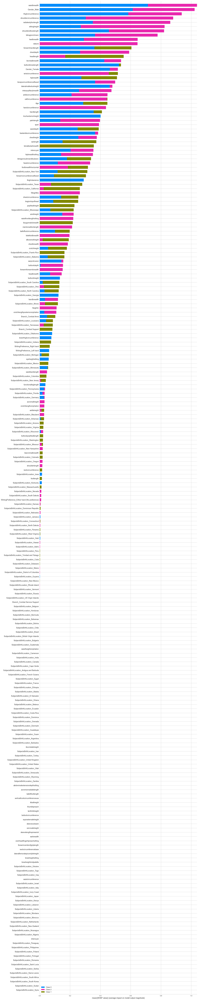

In [170]:
import shap

explainer = shap.LinearExplainer(model_shap, X_train_trans) #LinearExplainer

shap_values = explainer.shap_values(X_test_trans)

shap.summary_plot(shap_values,  max_display=300, feature_names = features, plot_size=(20,100))

# shap numpy 1.20 veya daha düşük versiyonunu ister.

# X_test datası üzerinden aldığımız shap değerleri data_leakege sebep olabileceğinden. shap değerlerini aşağıda train
# datası üzerinden alacağız.

# shap'ın çoğunlukla linear ve treebased modeller ile kullanımı tavsiye edilsede. KNN , SVM gibi non-parametrik modeller içinde
# shap değerleri alabilirsiniz.

In [171]:
shap_values

[array([[-0.34052034, -0.45148987, -0.08736717, ...,  0.52529543,
         -0.        ,  0.        ],
        [-0.34052034, -0.45148987,  0.03568518, ..., -0.4226061 ,
         -0.        , -0.        ],
        [-0.34052034, -0.45148987,  0.03568518, ..., -0.02764713,
         -0.        , -0.        ],
        ...,
        [-0.34052034, -0.45148987,  0.03568518, ...,  0.36731184,
          0.        ,  0.        ],
        [ 0.72360571,  0.95941597,  0.03568518, ..., -0.22512661,
         -0.        , -0.        ],
        [ 0.72360571,  0.95941597,  0.03568518, ..., -0.14613482,
         -0.        , -0.        ]]),
 array([[-0.        ,  0.        ,  0.09731339, ..., -0.29111078,
         -0.        ,  0.        ],
        [-0.        ,  0.        , -0.03974772, ...,  0.23420191,
         -0.        , -0.        ],
        [-0.        ,  0.        , -0.03974772, ...,  0.01532162,
         -0.        , -0.        ],
        ...,
        [-0.        ,  0.        , -0.03974772, ..., -

In [172]:
print(shap_values[0].shape)

(1135, 232)


In [178]:
hispanic=["SubjectsBirthLocation",  'handlength',  'forearmcircumferenceflexed', "headlength", 'bitragionsubmandibulararc',
          'footbreadthhorizontal',  'bimalleolarbreadth', 'poplitealheight', 'waistdepth', 'WritingPreference', 
          'tragiontopofhead','bideltoidbreadth', 'neckcircumferencebase', 'biacromialbreadth','buttockheight', 
          'buttockkneelength', 'earlength', 'axillaheight', "Age"]

In [179]:
X2 = X[hispanic]
X2.head()

,SubjectsBirthLocation,handlength,forearmcircumferenceflexed,headlength,bitragionsubmandibulararc,footbreadthhorizontal,bimalleolarbreadth,poplitealheight,waistdepth,WritingPreference,tragiontopofhead,bideltoidbreadth,neckcircumferencebase,biacromialbreadth,buttockheight,buttockkneelength,earlength,axillaheight,Age
0,Germany,184,265,191,301,91,65,362,217,Right hand,110,466,368,373,836,587,65,1180,26
1,California,189,247,180,270,91,64,426,168,Right hand,125,430,345,372,900,583,60,1292,21
2,Texas,195,262,207,270,100,69,398,159,Right hand,129,450,369,397,861,583,65,1271,23
3,District of Columbia,186,309,206,294,97,68,394,235,Right hand,125,484,386,384,897,599,62,1250,22
4,Texas,187,260,181,295,88,67,345,300,Right hand,116,525,358,378,811,607,65,1210,45


In [180]:
cat_new = X2.select_dtypes("object").columns
cat_new

Index(['SubjectsBirthLocation', 'WritingPreference'], dtype='object')

In [181]:
X2.shape

(5673, 19)

In [182]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y, test_size=0.2, random_state=101, stratify =y)

In [183]:
column_trans_shap = make_column_transformer((OneHotEncoder(handle_unknown="ignore", 
                                                           sparse=False), cat_new), 
                                             remainder=MinMaxScaler(),
                                             verbose_feature_names_out=False)

operations_shap = [("OneHotEncoder",column_trans_shap),
                   ("log", LogisticRegression(class_weight='balanced',
                                              max_iter=10000,
                                              random_state=101,
                                              penalty="l1",
                                              solver='saga'))]

pipe_shap_model = Pipeline(steps=operations_shap)
pipe_shap_model.fit(X_train2, y_train2)

Pipeline(steps=[('OneHotEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['SubjectsBirthLocation', 'WritingPreference'], dtype='object'))],
                                   verbose_feature_names_out=False)),
                ('log',
                 LogisticRegression(class_weight='balanced', max_iter=10000,
                                    penalty='l1', random_state=101,
                                    solver='saga'))])

In [184]:
eval_metric(pipe_shap_model, X_train2, y_train2, X_test2, y_test2)

Test_Set
[[200  12  43]
 [ 12 104  18]
 [108 132 506]]
              precision    recall  f1-score   support

       Black       0.62      0.78      0.70       255
    Hispanic       0.42      0.78      0.54       134
       White       0.89      0.68      0.77       746

    accuracy                           0.71      1135
   macro avg       0.65      0.75      0.67      1135
weighted avg       0.78      0.71      0.73      1135


Train_Set
[[ 870   46  103]
 [  31  423   80]
 [ 344  496 2145]]
              precision    recall  f1-score   support

       Black       0.70      0.85      0.77      1019
    Hispanic       0.44      0.79      0.56       534
       White       0.92      0.72      0.81      2985

    accuracy                           0.76      4538
   macro avg       0.69      0.79      0.71      4538
weighted avg       0.81      0.76      0.77      4538



In [185]:
model = Pipeline(steps=operations_shap)

scores = cross_validate(model, 
                        X_train2,
                        y_train2, 
                        scoring=scoring,
                        cv=5,
                        return_train_score=True)
df_scores = pd.DataFrame(scores, index = range(1, 6))
df_scores.mean()[2:]

test_f1_Hispanic            0.533704
train_f1_Hispanic           0.568046
test_precision_Hispanic     0.413856
train_precision_Hispanic    0.440271
test_recall_Hispanic        0.752848
train_recall_Hispanic       0.800554
dtype: float64

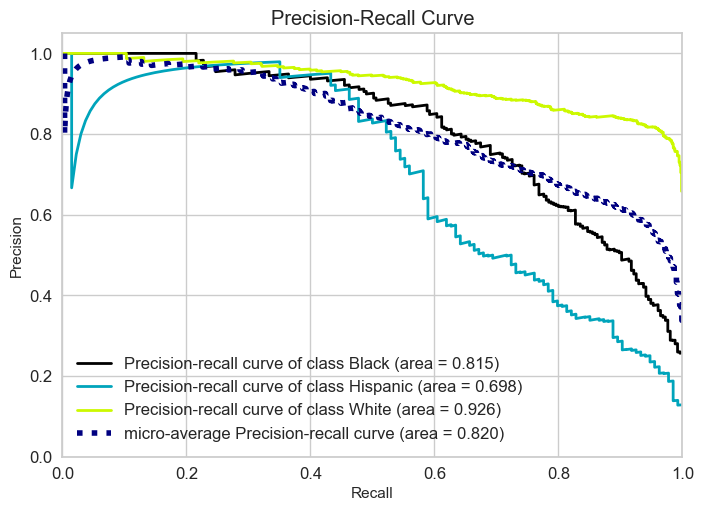

In [186]:
from scikitplot.metrics import plot_roc, precision_recall_curve
from scikitplot.metrics import plot_precision_recall


model = Pipeline(steps=operations_shap)

model.fit(X_train2, y_train2)

y_pred_proba = model.predict_proba(X_test2)
    
plot_precision_recall(y_test2, y_pred_proba)
plt.show();

In [189]:
# %% >> Visualize local predictions
shap.initjs()
# Force plot
prediction = log_model.predict(X_test[0:50])[0]
print(f"The log_model predicted: {prediction}")
shap.force_plot(explainer.expected_value[1],
                shap_values[1],
                X_test[0:50], # for values
                feature_names= X.columns,) 

NotFittedError: This LogisticRegression instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [177]:
shap.summary_plot(shap_values, X_train,max_display=300,feature_names = X.columns)

AssertionError: The shape of the shap_values matrix does not match the shape of the provided data matrix.

# Before the Deployment 
- Choose the model that works best based on your chosen metric
- For final step, fit the best model with whole dataset to get better performance.
- And your model ready to deploy, dump your model and scaler.

In [190]:
column_trans_final = make_column_transformer((OneHotEncoder(handle_unknown="ignore", 
                                                            sparse=False), cat),
                                              remainder=MinMaxScaler())

operations_final = [("OneHotEncoder",column_trans_final),
                    ("log", LogisticRegression(class_weight='balanced',
                                               max_iter=10000,
                                               random_state=101))]

final_model = Pipeline(steps=operations_final)

In [191]:
final_model.fit(X, y)

Pipeline(steps=[('OneHotEncoder',
                 ColumnTransformer(remainder=MinMaxScaler(),
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  Index(['Gender', 'Branch', 'SubjectsBirthLocation', 'WritingPreference'], dtype='object'))])),
                ('log',
                 LogisticRegression(class_weight='balanced', max_iter=10000,
                                    random_state=101))])

In [192]:
X[X.Gender=="Male"].describe()

# Datamızdaki tüm erkek askerlerin ortalama değerleri üzerinden modele tahmnin yaptıracağız.

,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,...,waistbreadth,waistcircumference,waistdepth,waistfrontlengthsitting,waistheightomphalion,wristcircumference,wristheight,Age,Heightin,Weightlbs
count,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,...,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000,3817.000000
mean,253.938695,1441.255960,335.383023,229.070212,1329.730155,251.767357,200.982709,415.439350,357.203825,275.059733,...,325.686665,938.311239,237.113440,387.290280,1057.465025,175.838879,847.698716,30.160335,70.036154,187.176840
std,35.639463,61.285929,16.949750,14.014361,57.950650,12.493577,10.157884,18.569521,33.102049,16.976340,...,33.190019,106.307121,33.108866,28.917454,51.291889,8.521337,40.505226,8.860464,2.827547,27.294101
min,163.000000,1194.000000,270.000000,190.000000,1106.000000,206.000000,167.000000,343.000000,246.000000,219.000000,...,235.000000,650.000000,161.000000,293.000000,876.000000,149.000000,695.000000,18.000000,60.000000,103.000000
25%,227.000000,1400.000000,324.000000,220.000000,1291.000000,243.000000,194.000000,403.000000,335.000000,263.000000,...,301.000000,857.000000,212.000000,367.000000,1022.000000,170.000000,819.000000,23.000000,68.000000,168.000000
50%,251.000000,1440.000000,335.000000,228.000000,1328.000000,252.000000,201.000000,415.000000,357.000000,275.000000,...,325.000000,937.000000,234.000000,386.000000,1056.000000,176.000000,847.000000,28.000000,70.000000,185.000000
75%,278.000000,1481.000000,346.000000,238.000000,1367.000000,260.000000,208.000000,427.000000,379.000000,287.000000,...,349.000000,1013.000000,260.000000,406.000000,1091.000000,181.000000,874.000000,37.000000,72.000000,206.000000
max,403.000000,1683.000000,393.000000,281.000000,1553.000000,303.000000,245.000000,489.000000,490.000000,332.000000,...,445.000000,1358.000000,379.000000,494.000000,1245.000000,211.000000,1009.000000,58.000000,80.000000,255.000000


In [193]:
male_mean_human = X[X.Gender=="Male"].describe(include="all").loc["mean"]
male_mean_human

# mean değerlerini loc["mean"] ile çekiyoruz. include="all" diyerek kategorik verilerinde döndürülmesini istiyoruz. 
# Kategorik veriler Nan döneceğinden bu kategorik gözlemlere aşağıdaki atamaları yapıyoruz.

abdominalextensiondepthsitting     253.938695
acromialheight                     1441.25596
acromionradialelength              335.383023
anklecircumference                 229.070212
axillaheight                      1329.730155
                                     ...     
SubjectsBirthLocation                     NaN
Age                                 30.160335
Heightin                            70.036154
Weightlbs                           187.17684
WritingPreference                         NaN
Name: mean, Length: 99, dtype: object

In [194]:
male_mean_human["Gender"] = "Male"
male_mean_human["SubjectsBirthLocation"] = "California"
male_mean_human["WritingPreference"] = "Right hand"

# ilgili atamaları yapıyoruz.

In [195]:
pd.DataFrame(male_mean_human).T

,abdominalextensiondepthsitting,acromialheight,acromionradialelength,anklecircumference,axillaheight,balloffootcircumference,balloffootlength,biacromialbreadth,bicepscircumferenceflexed,bicristalbreadth,...,waistheightomphalion,wristcircumference,wristheight,Gender,Branch,SubjectsBirthLocation,Age,Heightin,Weightlbs,WritingPreference
mean,253.938695,1441.25596,335.383023,229.070212,1329.730155,251.767357,200.982709,415.43935,357.203825,275.059733,...,1057.465025,175.838879,847.698716,Male,NaN,California,30.160335,70.036154,187.17684,Right hand


In [196]:
final_model.predict(pd.DataFrame(male_mean_human).T)

# erkek askerlerin ortalama değerleri hispanic askerlere çok yakınmış diyebiliriz.

array(['Hispanic'], dtype=object)

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___